Attempts to use the scenedetect - Python library to detect the boundaries of events. Version: 0.6.1

PySceneDetect docs: http://scenedetect.com/projects/Manual/en/latest/api.html

In [13]:
# imports

import pandas as pd
from scenedetect import open_video, SceneManager, StatsManager
from scenedetect.detectors import ContentDetector
import os

In [14]:
# function to detect changes in video

def detect_changes(video_path, threshold):
    video = open_video(video_path)
    stats_manager = StatsManager()
    scene_manager = SceneManager(stats_manager=stats_manager)

    # test weights
    weights=ContentDetector.Components(delta_hue=0.0, delta_sat=1.0, delta_lum=1.0, delta_edges=0.0)

    scene_manager.add_detector(
        ContentDetector(threshold=threshold, weights=weights))
    
    # detect potential boundaries of scenes
    scene_manager.detect_scenes(video, show_progress=False)

    # save processed video statistics
    stats_manager.save_to_csv('scenedetect_metrics.csv')

In [5]:
# read all videos

dir_path = '/media/madziegielewska/Seagate Expansion Drive/MAGISTERKA/diploma-project/videos'
files = []

for path in os.listdir(dir_path):
    if os.path.isfile(os.path.join(dir_path, path)):
        files.append(path)

files.sort()

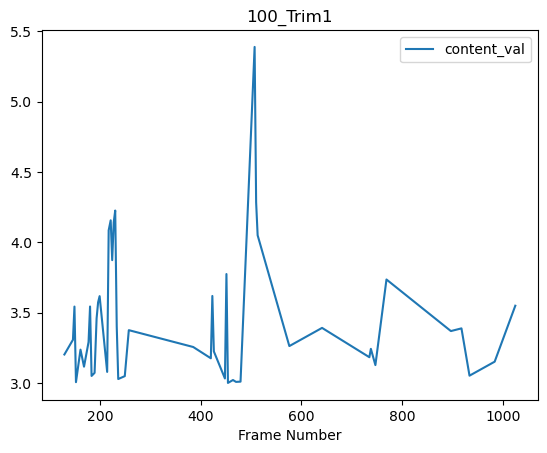

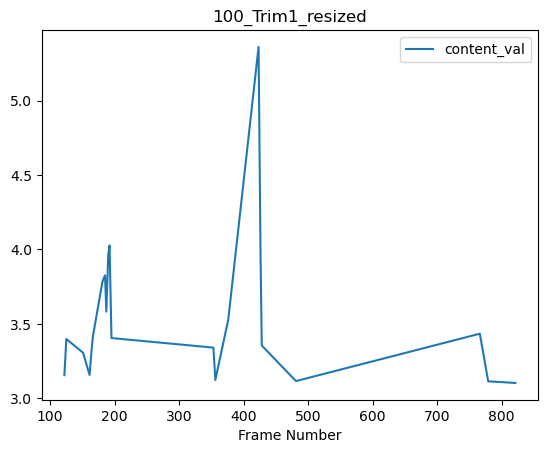

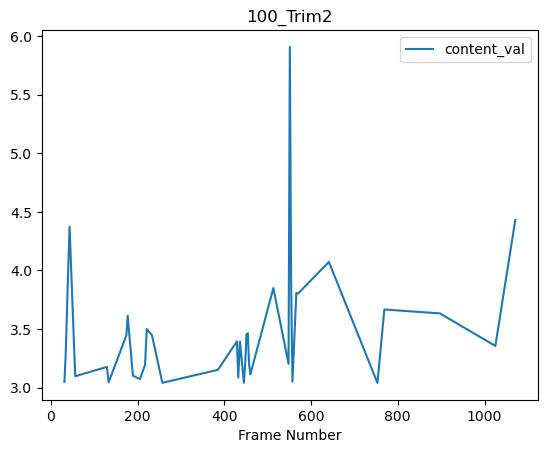

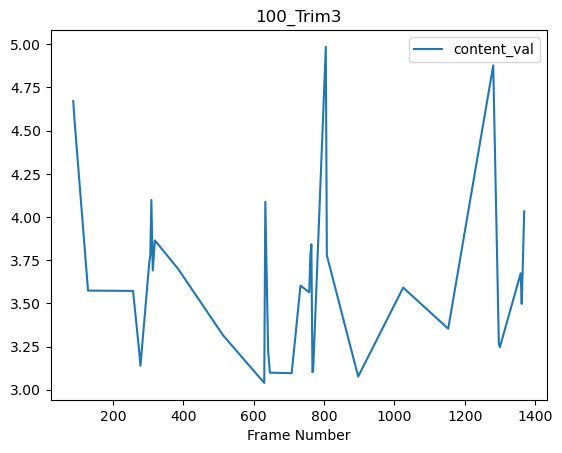

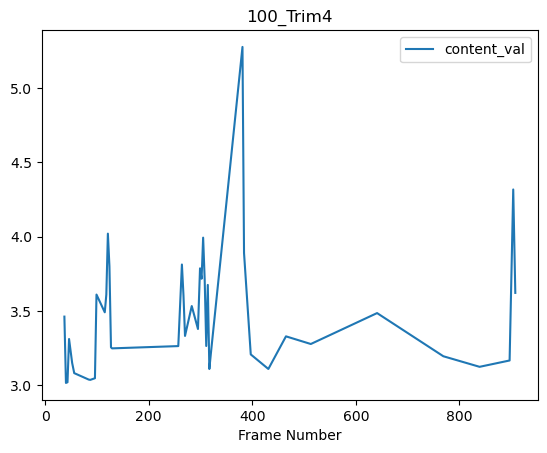

...

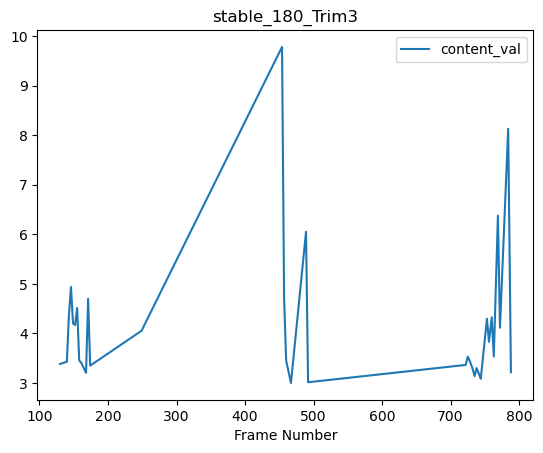

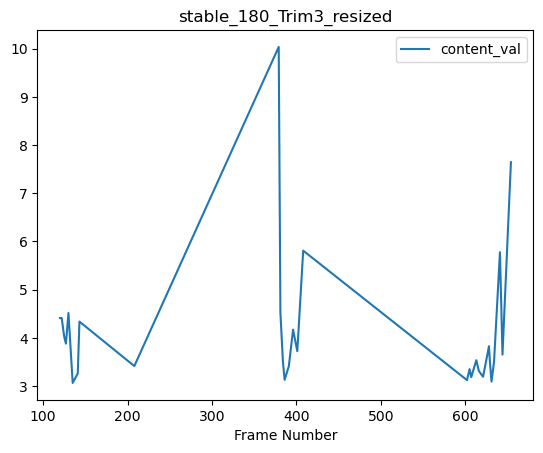

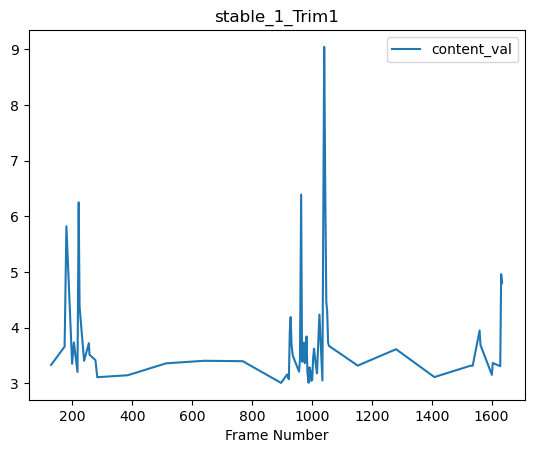

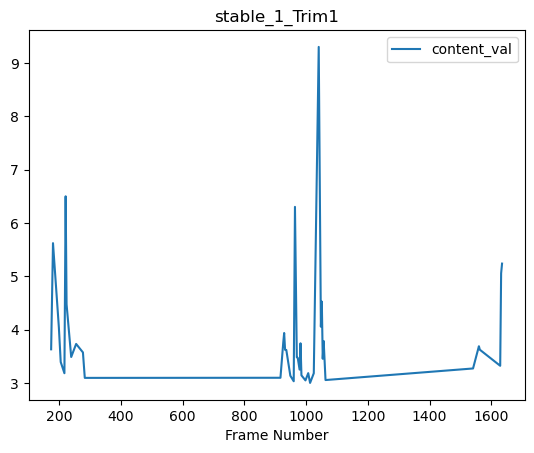

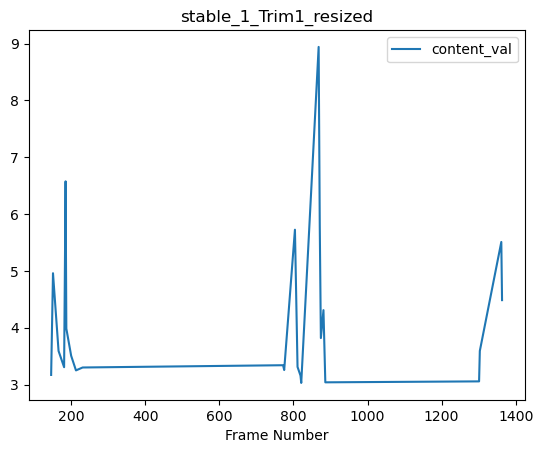

In [16]:
# detect changes in all videos

event_change_test = pd.DataFrame(columns=["video", "event_change"])

for file in files:
    filename, file_extension = os.path.splitext(f'{file}')

    # set threshold do 11.0
    detect_changes(f'/media/madziegielewska/Seagate Expansion Drive/MAGISTERKA/diploma-project/videos/{file}', threshold=10)
    
    # read saved csv file and filter lowest values
    graph = pd.read_csv('scenedetect_metrics.csv')
    content_val = graph[graph['content_val'] > 3]

    # plot graph of frame numbers to content values and save into file
    # note: he peaks in values correspond to the scene breaks in the input video
    # in some cases the threshold may need to be raised or lowered accordingly
    fig = content_val.plot.line(x='Frame Number', y='content_val', title=f'{filename}').get_figure()
    fig.savefig(f'graphs_diffweights/{filename}.jpg')

    # take highest value to get the most significant scene break
    max_value = graph['content_val'].idxmax()
    change = graph[graph['Frame Number'] == max_value]
    change_event = change.iloc[0]['Timecode']

    df = pd.DataFrame([{"video": f'{file}', "event_change": f'{change_event}'}])
    event_change_test = pd.concat([event_change_test, df])

# save test preprocessed data to csv
event_change_test.to_csv('test_data_diff.csv', index=False)


In [17]:
# read true data

df = pd.read_csv('data.csv')

videos = df['video'].tolist()
event_change_true = pd.to_datetime(df['event_change'], format='%H:%M:%S.%f').dt.time

event_change_true = event_change_true.tolist()

In [18]:
# read scenedetect data

df = pd.read_csv('test_data_diff.csv')

videos = df['video'].tolist()
event_change_test = pd.to_datetime(df['event_change'], format='%H:%M:%S.%f').dt.time

event_change_test = event_change_test.tolist()

In [19]:
# compare results

correct_detection = 0

for true_change, test_change in zip(event_change_true, event_change_test):
    # convert true and test time
    true_time = true_change.minute + true_change.second + true_change.microsecond/1000000
    test_time = test_change.minute + test_change.second + test_change.microsecond/1000000

    # include measurement uncertainty
    lower_tolerance = true_time - 0.400
    upper_tolerance = true_time + 0.400

    if ((test_time > lower_tolerance) and (test_time < upper_tolerance)):
        correct_detection += 1

print("correct detection: ", correct_detection)
print("incorrect detection: ", len(event_change_true) - correct_detection)
print(f"accuracy: {round(correct_detection/len(event_change_true)*100, 2)}%")

correct detection:  220
incorrect detection:  679
accuracy: 24.47%
